<a href="https://colab.research.google.com/github/Sparrow0hawk/DL-notebooks/blob/master/notebooks/DL_keras_LL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Deep Learning using Keras

Following a Linkedin learning pathway.

In [6]:
! curl -L https://files3.lynda.com/secure/courses/601801/exercises/Ex_Files_Building_Deep_Learning_Apps.zip?nvFjEtvoXaQ_uJHgKSscBUhn78Rbw6QZk67aayI5KVmYv77iYwrILDaIgrUs0Z-DDZuWXoAn3i0MUdcXmcsX9i4HKMdh3rwT8S9yyhqY5ZT17fGuoSYZWJSqCeqP9lyYt081uCdgfZt1OQ_h6n1MJHQtqRwuuoUYxAz666ApQAvT1qfmLdlc -o Ex_Files_Building_Deep_Learning_Apps.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1205k  100 1205k    0     0  8089k      0 --:--:-- --:--:-- --:--:-- 8089k


In [7]:
! ls -l

total 2420
-rw-r--r-- 1 root root 1234244 Sep  2 14:06  Ex_Files_Building_Deep_Learning_Apps.zip
-rw-r--r-- 1 root root 1234244 Sep  2 14:05 'Ex_Files_Building_Deep_Learning_Apps.zip?nvFjEtvoXaQ_uJHgKSscBUhn78Rbw6QZk67aayI5KVmYv77iYwrILDaIgrUs0Z-DDZuWXoAn3i0MUdcXmcsX9i4HKMdh3rwT8S9yyhqY5ZT17fGuoSYZWJSqCeqP9lyYt081uCdgfZt1OQ_h6n1MJHQtqRwuuoUYxAz666ApQAvT1qfmLdlc'
drwxr-xr-x 1 root root    4096 Aug 27 16:39  sample_data


In [8]:
! unzip Ex_Files_Building_Deep_Learning_Apps.zip

Archive:  Ex_Files_Building_Deep_Learning_Apps.zip
   creating: Ex_Files_Building_Deep_Learning_Apps/
   creating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/
   creating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/05/
  inflating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/05/image_recognition final.py  
  inflating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/05/bay.jpg  
  inflating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/05/image_recognition.py  
   creating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/06/
  inflating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/06/visualize_training final.py  
  inflating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/06/sales_data_test_scaled.csv  
  inflating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/06/model_logging.py  
  inflating: Ex_Files_Building_Deep_Learning_Apps/Exercise Files/06/sales_data_training_scaled.csv  
  inflating: Ex_Files_Building_Deep_Learning_

Rough keras train-test-save cycle

In [ ]:

model = keras.model.Sequential()

model.add(keras.layers.Dense())

model.compile(loss='mean_squared_error', optimizer='adam')


In [ ]:
# training

model.fit(training_data, expected_output)

In [ ]:
# testing phase

error_rate = model.evaluate(testing_data, expected_output)

model.save('trained_model.h5')

In [ ]:

model = keras.models.load_model('trained_model.h5')


In [ ]:
# sequential model API is simplest form in keras
# allows us to sequentially add layers

model = keras.models.Sequential()

# adds a dense layer with 32 nodes, (dense layer means every node is connected to every node in the previous layer)
model.add(Dense(32, input_dim=9)
model.add(Dense(128))
model.add(Dense(1))

In [ ]:
# keras also supports convolutional and recurrent layers 

In [11]:
# predicting future video game sales

import pandas as pd

pd.read_csv('/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/03/sales_data_test.csv')

,critic_rating,is_action,is_exclusive_to_us,is_portable,is_role_playing,is_sequel,is_sports,suitable_for_kids,total_earnings,unit_price
0,3.5,1,1,1,0,1,0,1,247537,59.99
1,2.5,0,0,0,1,1,0,0,73960,59.99
2,3.5,0,0,0,0,1,1,0,82671,59.99
3,4.0,1,1,0,0,1,0,0,137456,39.99
4,2.0,1,0,1,0,1,0,0,89639,59.99
...,...,...,...,...,...,...,...,...,...,...
395,4.5,1,0,0,0,0,0,0,95816,59.99
396,4.0,1,0,0,0,1,0,0,121947,59.99
397,5.0,1,1,1,0,0,0,0,142313,39.99
398,2.0,1,1,0,0,0,0,0,61549,39.99


In [15]:
from keras.models import Sequential 
from keras.layers import *

training_data_df = pd.read_csv("/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/03/sales_data_training_scaled.csv")

X = training_data_df.drop("total_earnings", axis=1).values
Y = training_data_df['total_earnings'].values

model = Sequential()
model.add(Dense(50, input_dim=9, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(1, activation='linear'))

model.compile(loss='mse', optimizer='adam')



In [16]:
# epochs or passes over the training data
model.fit(
    X,Y, epochs=50, shuffle=True, verbose=2
)

test_data_df = pd.read_csv("/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/04/sales_data_test_scaled.csv")

X_test = test_data_df.drop('total_earnings', axis=1).values
Y_test = test_data_df[['total_earnings']].values


test_error_rate = model.evaluate(X_test, Y_test, verbose=0)
print("The mean squared error (MSE) for the test data set is: {}".format(test_error_rate))

Epoch 1/50
32/32 - 0s - loss: 0.0119
Epoch 2/50
32/32 - 0s - loss: 0.0020
Epoch 3/50
32/32 - 0s - loss: 9.2038e-04
Epoch 4/50
32/32 - 0s - loss: 5.1947e-04
Epoch 5/50
32/32 - 0s - loss: 3.3285e-04
Epoch 6/50
32/32 - 0s - loss: 2.1068e-04
Epoch 7/50
32/32 - 0s - loss: 1.4879e-04
Epoch 8/50
32/32 - 0s - loss: 1.0668e-04
Epoch 9/50
32/32 - 0s - loss: 7.6825e-05
Epoch 10/50
32/32 - 0s - loss: 6.6041e-05
Epoch 11/50
32/32 - 0s - loss: 7.9103e-05
Epoch 12/50
32/32 - 0s - loss: 5.8840e-05
Epoch 13/50
32/32 - 0s - loss: 4.3264e-05
Epoch 14/50
32/32 - 0s - loss: 5.1992e-05
Epoch 15/50
32/32 - 0s - loss: 4.9686e-05
Epoch 16/50
32/32 - 0s - loss: 3.5807e-05
Epoch 17/50
32/32 - 0s - loss: 3.7791e-05
Epoch 18/50
32/32 - 0s - loss: 3.6818e-05
Epoch 19/50
32/32 - 0s - loss: 3.3431e-05
Epoch 20/50
32/32 - 0s - loss: 2.4556e-05
Epoch 21/50
32/32 - 0s - loss: 2.6785e-05
Epoch 22/50
32/32 - 0s - loss: 3.3118e-05
Epoch 23/50
32/32 - 0s - loss: 3.7766e-05
Epoch 24/50
32/32 - 0s - loss: 3.2895e-05
Epoch 25/

In [17]:
# making predictions with exsiting model

X = pd.read_csv("/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/04/proposed_new_product.csv").values

In [18]:
prediction = model.predict(X)

prediction = prediction[0][0]

# reverse scaling

prediction = prediction + 0.1159
prediction = prediction / 0.0000036968

print("Earnings Prediction for Proposed Product - ${}".format(prediction))

Earnings Prediction for Proposed Product - $265390.3956796101


In [19]:
model.save('trained_model.h5')

In [20]:
from keras.models import load_model

oldmodel = load_model('trained_model.h5')

In [21]:
# using builtin image models
from keras.preprocessing import image
from keras.applications import resnet50

model = resnet50.ResNet50()

img = image.load_img("/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/05/bay.jpg")

102973440/102967424 [==============================] - 1s 0us/step


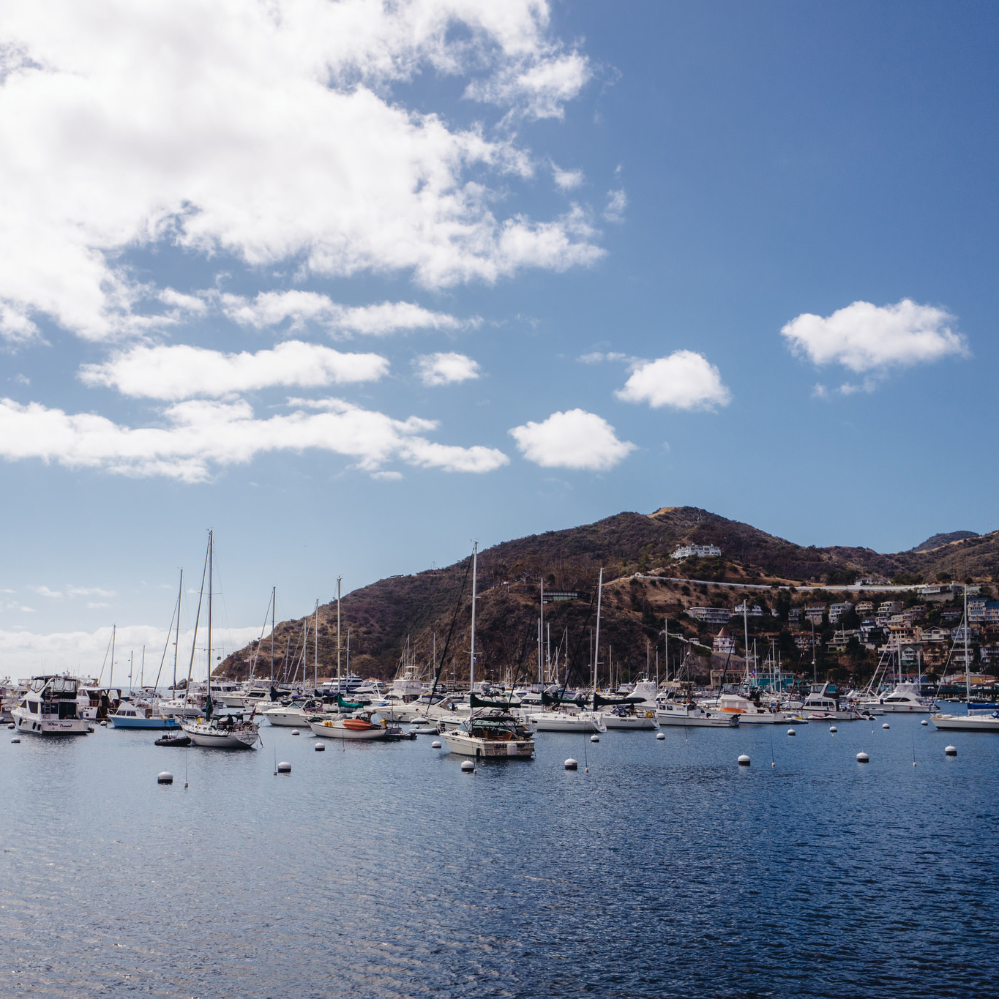

In [22]:
img

In [23]:
# when you feed images into NN the size of image has match the number of input nodes
# for resnet50 this must be 224x224 pixels

img = image.load_img("/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/05/bay.jpg", target_size=(224,224))

In [25]:
x = image.img_to_array(img)

In [28]:
# creates 3d array, height, width and colour (RGB)
x

array([[[243., 243., 245.],
        [244., 244., 244.],
        [245., 245., 247.],
        ...,
        [ 70., 107., 162.],
        [ 69., 105., 163.],
        [ 69., 106., 161.]],

       [[244., 244., 246.],
        [245., 245., 247.],
        [245., 245., 245.],
        ...,
        [ 67., 102., 160.],
        [ 67., 103., 161.],
        [ 62., 101., 158.]],

       [[245., 245., 247.],
        [243., 243., 245.],
        [245., 245., 245.],
        ...,
        [ 70., 107., 162.],
        [ 72., 109., 161.],
        [ 63., 102., 157.]],

       ...,

       [[129., 136., 154.],
        [117., 124., 142.],
        [161., 165., 177.],
        ...,
        [ 31.,  55.,  91.],
        [ 47.,  75., 112.],
        [ 20.,  43.,  77.]],

       [[140., 146., 160.],
        [132., 143., 161.],
        [112., 120., 139.],
        ...,
        [ 47.,  68.,  99.],
        [ 21.,  32.,  50.],
        [ 30.,  50.,  75.]],

       [[149., 146., 153.],
        [151., 149., 160.],
        [138., 1

In [29]:
import numpy as np

# add a fourth direction as keras expects list of images
x = np.expand_dims(x, axis=0)

x = resnet50.preprocess_input(x)

In [30]:
prediction = model.predict(x)

In [32]:
predicted_classes = resnet50.decode_predictions(prediction, top=9)

40960/35363 [==================================] - 0s 0us/step


In [34]:
print('This is an image of:')

for imagenet_id, name, likelihood in predicted_classes[0]:
  print(f" {name}: {round(likelihood,2)} likelihood")

This is an image of:
 seashore: 0.5699999928474426 likelihood
 lakeside: 0.28999999165534973 likelihood
 dock: 0.07999999821186066 likelihood
 breakwater: 0.03999999910593033 likelihood
 promontory: 0.009999999776482582 likelihood
 catamaran: 0.0 likelihood
 sandbar: 0.0 likelihood
 trimaran: 0.0 likelihood
 pier: 0.0 likelihood


In [40]:
import pandas as pd
import keras
from keras.models import Sequential
from keras.layers import *

training_data_df = pd.read_csv("/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/03/sales_data_training_scaled.csv")

X = training_data_df.drop('total_earnings', axis=1).values
Y = training_data_df[['total_earnings']].values

# Define the model
model = Sequential()
model.add(Dense(50, input_dim=9, activation='relu', name='layer_1'))
model.add(Dense(100, activation='relu', name='layer_2'))
model.add(Dense(50, activation='relu', name='layer_3'))
model.add(Dense(1, activation='linear', name='output_layer'))
model.compile(loss='mean_squared_error', optimizer='adam')

# Create a TensorBoard logger
logger = keras.callbacks.TensorBoard(
    log_dir = "/content/logs",
    write_graph = True,
    histogram_freq = 5
)

In [41]:
# Train the model
model.fit(
    X,
    Y,
    epochs=50,
    shuffle=True,
    verbose=2,
    callbacks = [logger]
)

# Load the separate test data set
test_data_df = pd.read_csv("/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/03/sales_data_test_scaled.csv")

X_test = test_data_df.drop('total_earnings', axis=1).values
Y_test = test_data_df[['total_earnings']].values

test_error_rate = model.evaluate(X_test, Y_test, verbose=0)
print("The mean squared error (MSE) for the test data set is: {}".format(test_error_rate))

Epoch 1/50
32/32 - 0s - loss: 0.0446
Epoch 2/50
32/32 - 0s - loss: 0.0047
Epoch 3/50
32/32 - 0s - loss: 0.0015
Epoch 4/50
32/32 - 0s - loss: 7.0876e-04
Epoch 5/50
32/32 - 0s - loss: 4.0272e-04
Epoch 6/50
32/32 - 0s - loss: 2.6025e-04
Epoch 7/50
32/32 - 0s - loss: 1.8436e-04
Epoch 8/50
32/32 - 0s - loss: 1.5395e-04
Epoch 9/50
32/32 - 0s - loss: 1.0494e-04
Epoch 10/50
32/32 - 0s - loss: 8.1724e-05
Epoch 11/50
32/32 - 0s - loss: 7.4449e-05
Epoch 12/50
32/32 - 0s - loss: 6.5093e-05
Epoch 13/50
32/32 - 0s - loss: 5.7672e-05
Epoch 14/50
32/32 - 0s - loss: 4.8868e-05
Epoch 15/50
32/32 - 0s - loss: 4.6510e-05
Epoch 16/50
32/32 - 0s - loss: 4.6129e-05
Epoch 17/50
32/32 - 0s - loss: 3.6896e-05
Epoch 18/50
32/32 - 0s - loss: 3.6809e-05
Epoch 19/50
32/32 - 0s - loss: 3.0744e-05
Epoch 20/50
32/32 - 0s - loss: 2.8504e-05
Epoch 21/50
32/32 - 0s - loss: 2.7638e-05
Epoch 22/50
32/32 - 0s - loss: 2.7408e-05
Epoch 23/50
32/32 - 0s - loss: 2.3948e-05
Epoch 24/50
32/32 - 0s - loss: 2.2749e-05
Epoch 25/50
3

In [43]:
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [46]:
import pandas as pd
import keras
from keras.models import Sequential
from keras.layers import *


RUN_NAME = "run2_5nodes"

training_data_df = pd.read_csv("/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/06/sales_data_training_scaled.csv")

X = training_data_df.drop('total_earnings', axis=1).values
Y = training_data_df[['total_earnings']].values

# Define the model
model = Sequential()
model.add(Dense(5, input_dim=9, activation='relu', name='layer_1'))
model.add(Dense(100, activation='relu', name='layer_2'))
model.add(Dense(50, activation='relu', name='layer_3'))
model.add(Dense(1, activation='linear', name='output_layer'))
model.compile(loss='mean_squared_error', optimizer='adam')

# Create a TensorBoard logger
logger = keras.callbacks.TensorBoard(
    log_dir=f'newlogs/{RUN_NAME}',
    histogram_freq=5,
    write_graph=True
)

In [47]:
# Train the model
model.fit(
    X,
    Y,
    epochs=50,
    shuffle=True,
    verbose=2,
    callbacks=[logger]
)

# Load the separate test data set
test_data_df = pd.read_csv("/content/Ex_Files_Building_Deep_Learning_Apps/Exercise Files/06/sales_data_test_scaled.csv")

X_test = test_data_df.drop('total_earnings', axis=1).values
Y_test = test_data_df[['total_earnings']].values

test_error_rate = model.evaluate(X_test, Y_test, verbose=0)
print("The mean squared error (MSE) for the test data set is: {}".format(test_error_rate))

Epoch 1/50
32/32 - 0s - loss: 0.0490
Epoch 2/50
32/32 - 0s - loss: 0.0255
Epoch 3/50
32/32 - 0s - loss: 0.0211
Epoch 4/50
32/32 - 0s - loss: 0.0184
Epoch 5/50
32/32 - 0s - loss: 0.0161
Epoch 6/50
32/32 - 0s - loss: 0.0141
Epoch 7/50
32/32 - 0s - loss: 0.0118
Epoch 8/50
32/32 - 0s - loss: 0.0102
Epoch 9/50
32/32 - 0s - loss: 0.0086
Epoch 10/50
32/32 - 0s - loss: 0.0076
Epoch 11/50
32/32 - 0s - loss: 0.0064
Epoch 12/50
32/32 - 0s - loss: 0.0055
Epoch 13/50
32/32 - 0s - loss: 0.0049
Epoch 14/50
32/32 - 0s - loss: 0.0042
Epoch 15/50
32/32 - 0s - loss: 0.0036
Epoch 16/50
32/32 - 0s - loss: 0.0031
Epoch 17/50
32/32 - 0s - loss: 0.0027
Epoch 18/50
32/32 - 0s - loss: 0.0024
Epoch 19/50
32/32 - 0s - loss: 0.0019
Epoch 20/50
32/32 - 0s - loss: 0.0014
Epoch 21/50
32/32 - 0s - loss: 0.0012
Epoch 22/50
32/32 - 0s - loss: 9.8643e-04
Epoch 23/50
32/32 - 0s - loss: 8.5207e-04
Epoch 24/50
32/32 - 0s - loss: 8.1417e-04
Epoch 25/50
32/32 - 0s - loss: 6.8686e-04
Epoch 26/50
32/32 - 0s - loss: 5.9833e-04
E

In [48]:
%load_ext tensorboard
%tensorboard --logdir newlogs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>